### House Price Prediction
### Student Name: Ridwan Adeniyi
### Student Number: 1366306
### Assignment: Ames housing dataset

This project aimed to predict the prices of unseen houses with the aid of a **linear regression model** by learning from a known dataset containing different house features and known prices.

I will be importing different libraries, such as pandas, which helps with data manipulation and analysis, numpy for numerical operations, matplotlib for plotting modules, and seaborn for aided data visualization, to help with the data preprocessing.

In [ ]:
# Importing import libraries for manipulation and analysis
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme()

##### Reading the required dataset to be analysed from the system's memory.

In [ ]:
# Loading the dataset
training_data = pd.read_csv('/Housing_Data_Train.csv')
test_data =pd.read_csv('/Housing_Data_Test.csv')
print(training_data.head(10))

   Unnamed: 0    Id  MSSubClass MSZoning  LotFrontage  LotArea Street Alley  \
0           0   149          20       RL         63.0     7500   Pave   NaN   
1           1   460          50       RL          NaN     7015   Pave   NaN   
2           2  1336          20       RL         80.0     9650   Pave   NaN   
3           3   805          20       RL         75.0     9000   Pave   NaN   
4           4  1396          60       RL         88.0    12665   Pave   NaN   
5           5   155          30       RM         84.0    11340   Pave   NaN   
6           6   777          20       RL         86.0    11210   Pave   NaN   
7           7  1171          80       RL         76.0     9880   Pave   NaN   
8           8   923          20       RL         65.0    10237   Pave   NaN   
9           9   281          60       RL         82.0    11287   Pave   NaN   

  LotShape LandContour  ... PoolArea PoolQC  Fence MiscFeature MiscVal MoSold  \
0      Reg         Lvl  ...        0    NaN    Na

In [ ]:
# To check the number of columns and rows of the dataset
print(training_data.shape)

(1000, 82)


# **Data Pre-processing**

## Data Cleaning- Null values and Duplicates


To drop the Id and the Unnamed: 0 columns as they are not useful variables for the dataset.

In [ ]:
# To drop the Id and Unnamed:0 columns
training_data = training_data.drop(['Id', 'Unnamed: 0'], axis=1)

In [ ]:
# To get a better description of my dataset
print(training_data.describe().T)

                count           mean           std      min        25%  \
MSSubClass     1000.0      58.165000     43.579318     20.0      20.00   
LotFrontage     814.0      70.120393     25.730561     21.0      59.00   
LotArea        1000.0   10778.454000  11647.964726   1477.0    7559.50   
OverallQual    1000.0       6.088000      1.365328      1.0       5.00   
OverallCond    1000.0       5.578000      1.108668      1.0       5.00   
YearBuilt      1000.0    1970.550000     30.609908   1872.0    1953.00   
YearRemodAdd   1000.0    1984.620000     20.682296   1950.0    1966.75   
MasVnrArea      994.0     100.989940    169.554306      0.0       0.00   
BsmtFinSF1     1000.0     440.793000    459.445085      0.0       0.00   
BsmtFinSF2     1000.0      46.877000    163.906355      0.0       0.00   
BsmtUnfSF      1000.0     566.091000    436.109714      0.0     222.25   
TotalBsmtSF    1000.0    1053.761000    436.063012      0.0     800.00   
1stFlrSF       1000.0    1157.822000  

In [ ]:
# To check detailed infomation of the dataset, which shows the columns with null values
print(training_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     1000 non-null   int64  
 1   MSZoning       1000 non-null   object 
 2   LotFrontage    814 non-null    float64
 3   LotArea        1000 non-null   int64  
 4   Street         1000 non-null   object 
 5   Alley          66 non-null     object 
 6   LotShape       1000 non-null   object 
 7   LandContour    1000 non-null   object 
 8   Utilities      1000 non-null   object 
 9   LotConfig      1000 non-null   object 
 10  LandSlope      1000 non-null   object 
 11  Neighborhood   1000 non-null   object 
 12  Condition1     1000 non-null   object 
 13  Condition2     1000 non-null   object 
 14  BldgType       1000 non-null   object 
 15  HouseStyle     1000 non-null   object 
 16  OverallQual    1000 non-null   int64  
 17  OverallCond    1000 non-null   int64  
 18  YearBuilt

<Axes: >

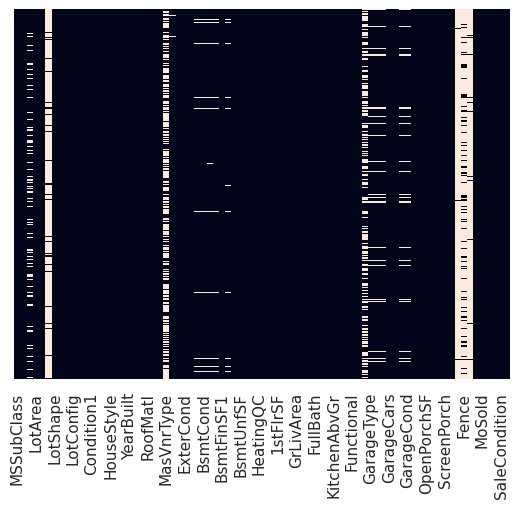

In [ ]:
# To check a visual heatmap of the null values
sns.heatmap(training_data.isnull(), yticklabels = False , cbar = False)

In [ ]:
# To create a list of the columns to show the sum of the missing values in the individual columns

training_data_dict = list(zip(training_data.columns, training_data.isnull().sum()))
print(training_data_dict)

[('MSSubClass', 0), ('MSZoning', 0), ('LotFrontage', 186), ('LotArea', 0), ('Street', 0), ('Alley', 934), ('LotShape', 0), ('LandContour', 0), ('Utilities', 0), ('LotConfig', 0), ('LandSlope', 0), ('Neighborhood', 0), ('Condition1', 0), ('Condition2', 0), ('BldgType', 0), ('HouseStyle', 0), ('OverallQual', 0), ('OverallCond', 0), ('YearBuilt', 0), ('YearRemodAdd', 0), ('RoofStyle', 0), ('RoofMatl', 0), ('Exterior1st', 0), ('Exterior2nd', 0), ('MasVnrType', 596), ('MasVnrArea', 6), ('ExterQual', 0), ('ExterCond', 0), ('Foundation', 0), ('BsmtQual', 25), ('BsmtCond', 25), ('BsmtExposure', 26), ('BsmtFinType1', 25), ('BsmtFinSF1', 0), ('BsmtFinType2', 26), ('BsmtFinSF2', 0), ('BsmtUnfSF', 0), ('TotalBsmtSF', 0), ('Heating', 0), ('HeatingQC', 0), ('CentralAir', 0), ('Electrical', 1), ('1stFlrSF', 0), ('2ndFlrSF', 0), ('LowQualFinSF', 0), ('GrLivArea', 0), ('BsmtFullBath', 0), ('BsmtHalfBath', 0), ('FullBath', 0), ('HalfBath', 0), ('BedroomAbvGr', 0), ('KitchenAbvGr', 0), ('KitchenQual', 0)

In [ ]:
(training_data['MasVnrType'] == 'None').sum()

np.int64(0)

In [ ]:
# None in the MasVnrType are being regarded as null values which continues to mess with the cleaning of this dataset.

training_data['MasVnrType'] = training_data['MasVnrType'].astype(object).where(training_data['MasVnrType'].notna(), 'None')

#####  The columns with high numbers of missing values are paid close attention

In [ ]:
# To check number of unique features and their null values
for col in ['PoolQC','Fence','MiscFeature','FireplaceQu','MasVnrType', 'Alley','LotFrontage']:
  print(f'No. of unique features in {col}: {len(training_data[col].unique())}',
        '\n',
        f'No of NaN values in {col}: {training_data[col].isna().sum()}' '\n')

No. of unique features in PoolQC: 4 
 No of NaN values in PoolQC: 995

No. of unique features in Fence: 5 
 No of NaN values in Fence: 815

No. of unique features in MiscFeature: 5 
 No of NaN values in MiscFeature: 964

No. of unique features in FireplaceQu: 6 
 No of NaN values in FireplaceQu: 465

No. of unique features in MasVnrType: 4 
 No of NaN values in MasVnrType: 0

No. of unique features in Alley: 3 
 No of NaN values in Alley: 934

No. of unique features in LotFrontage: 105 
 No of NaN values in LotFrontage: 186



### Exploring Pool Quality and Pool Area

In [ ]:
training_data['PoolQC'].value_counts()

,count
PoolQC,
Gd,2
Fa,2
Ex,1


In [ ]:
training_data['PoolQC'].isnull().sum()

np.int64(995)

In [ ]:
training_data['PoolArea'].value_counts()

,count
PoolArea,
0,995
576,1
480,1
648,1
512,1
519,1


From the analysis, the null values in the pool quality [PoolQC] is same as the pools that have 0 sqft area in [PoolArea]. Therefore, the missing values in PoolQC can be filled with NA as it means No Pool in the data description.

In [ ]:
# Filling the null values in PoolQC with NA
training_data.fillna({'PoolQC': 'NA'}, inplace=True)

### Exploring Fireplaces and FireplaceQC

In [ ]:
training_data['FireplaceQu'].value_counts()

,count
FireplaceQu,
Gd,272
TA,210
Fa,21
Po,16
Ex,16


In [ ]:
training_data['FireplaceQu'].isnull().sum()

np.int64(465)

In [ ]:
training_data['Fireplaces'].value_counts()

,count
Fireplaces,
0,465
1,444
2,87
3,4


From the analysis, the null values in the Fireplace quality [FireplaceQu] is same as the houses with no or 0 Fireplaces [Fireplaces]. Therefore, the missing values in FireplaceQu can be filled with NA as it means No Fireplace in the data description.

In [ ]:
# Filling the null values in FireplaceQu with NA
training_data.fillna({'FireplaceQu' : 'NA'}, inplace = True)

In [ ]:
training_data.isnull().sum().sort_values(ascending=False).head(20)

,0
MiscFeature,964
Alley,934
Fence,815
LotFrontage,186
GarageYrBlt,61
GarageFinish,61
GarageCond,61
GarageQual,61
GarageType,61
BsmtExposure,26


######  The remaining columns with missing data are LotFrontage, GarageCond, GarageFinish, GarageType, GarageQual, GarageYrBlt, BsmtFinType2, BsmtExposure, BsmtQual, BsmtFinType1, BsmtCond, MasVnrArea, Fence, MiscFeature, Alley

### Exploring Garage Related Features

#####  The null values in the garage related features which are 'GarageCond', 'GarageFinish', 'GarageType', 'GarageQual', 'GarageYrBlt are all 61 which gives some insight to this. There is a common information missing in all which might be because there are no garages in these houses. However, further analysis would be done to check this.

In [ ]:
# Creating a mini dataset containing only the garage features
training_data_garage = training_data[[
    'GarageCond',
    'GarageFinish',
    'GarageType',
    'GarageCars',
    'GarageArea',
    'GarageQual',
    'GarageYrBlt',
]]

training_data_garage.isnull().sum()

,0
GarageCond,61
GarageFinish,61
GarageType,61
GarageCars,0
GarageArea,0
GarageQual,61
GarageYrBlt,61


<Axes: >

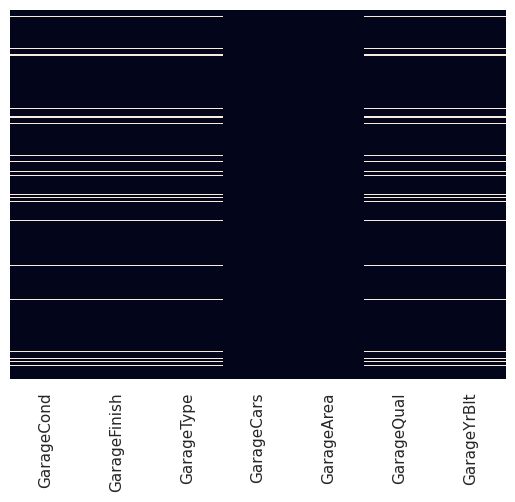

In [ ]:
# Plotting an heatmap to see the position of individual entries on the dataset
sns.heatmap(training_data_garage.isnull(), yticklabels = False, cbar = False)

#####  This plot suggests that the missing values in these set of columns comes from same set of entries. This is logical since a garage that does not exist would not have been built; therefore, not having Garage Year Built.

#####  With this information, i will be filling the missing values with NA and 0 as required.

In [ ]:
training_data = training_data.fillna({'GarageCond' : 'NA', 'GarageFinish' : 'NA', 'GarageType' : 'NA', 'GarageQual' : 'NA', 'GarageYrBlt' : 0})

In [ ]:
training_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     1000 non-null   int64  
 1   MSZoning       1000 non-null   object 
 2   LotFrontage    814 non-null    float64
 3   LotArea        1000 non-null   int64  
 4   Street         1000 non-null   object 
 5   Alley          66 non-null     object 
 6   LotShape       1000 non-null   object 
 7   LandContour    1000 non-null   object 
 8   Utilities      1000 non-null   object 
 9   LotConfig      1000 non-null   object 
 10  LandSlope      1000 non-null   object 
 11  Neighborhood   1000 non-null   object 
 12  Condition1     1000 non-null   object 
 13  Condition2     1000 non-null   object 
 14  BldgType       1000 non-null   object 
 15  HouseStyle     1000 non-null   object 
 16  OverallQual    1000 non-null   int64  
 17  OverallCond    1000 non-null   int64  
 18  YearBuilt

######  The remaining columns with missing data are LotFrontage, BsmtFinType2, BsmtExposure, BsmtQual, BsmtFinType1, BsmtCond, MasVnrArea, Fence, MiscFeature, Alley

In [ ]:
training_data[['LotFrontage', 'BsmtFinType2', 'BsmtExposure',
               'BsmtQual', 'BsmtFinType1', 'BsmtCond', 'MasVnrArea']].isnull().sum()

,0
LotFrontage,186
BsmtFinType2,26
BsmtExposure,26
BsmtQual,25
BsmtFinType1,25
BsmtCond,25
MasVnrArea,6


In [ ]:
training_data[['BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2','BsmtFinSF2']] [training_data['BsmtFinType1'].isnull() & training_data['BsmtFinType2'].isnull()]

,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2
27,NaN,0,NaN,0
35,NaN,0,NaN,0
36,NaN,0,NaN,0
60,NaN,0,NaN,0
92,NaN,0,NaN,0
223,NaN,0,NaN,0
238,NaN,0,NaN,0
267,NaN,0,NaN,0
546,NaN,0,NaN,0
570,NaN,0,NaN,0


##### From the data description, the BsmtFinSF1 means Type 1 finished basement square feet while BsmtFinType1, which has missing values, is the Rating of basement finished area. From the code above, the basement square feet of the missing parts of the Rating of basement finished area states 0, which therefore means 'No basement'. Therefore, I'd be filling the empty cells with NA. Vice versa for the BsmtFinType2, BsmtExposure, BsmtQual, BsmtCond.

In [ ]:
training_data = training_data.fillna({'BsmtFinType1' : 'NA','BsmtFinType2' : 'NA','BsmtExposure' : 'NA', 'BsmtQual' : 'NA', 'BsmtCond' : 'NA'})

###### The remaining columns with missing data are MasVnrArea, Fence, MiscFeature, Alley, and LotFrontage.

### Masonry Veneer Features

In [ ]:
# To check the MasVnrArea with null values and match with MasVnrType to see the relationship

training_data[['MasVnrArea', 'MasVnrType']] [training_data['MasVnrArea'].isnull()]

,MasVnrArea,MasVnrType
16,NaN,None
73,NaN,None
103,NaN,None
253,NaN,None
272,NaN,None
321,NaN,None


#####  The above output shows that all the null values are as a result of the Masonry veneer type being 'None' which means no Masonry veneer; therefore, the area would definately be 0 as it does not exist.

In [ ]:
training_data.fillna({'MasVnrArea' : 0}, inplace = True)

In [ ]:
training_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     1000 non-null   int64  
 1   MSZoning       1000 non-null   object 
 2   LotFrontage    814 non-null    float64
 3   LotArea        1000 non-null   int64  
 4   Street         1000 non-null   object 
 5   Alley          66 non-null     object 
 6   LotShape       1000 non-null   object 
 7   LandContour    1000 non-null   object 
 8   Utilities      1000 non-null   object 
 9   LotConfig      1000 non-null   object 
 10  LandSlope      1000 non-null   object 
 11  Neighborhood   1000 non-null   object 
 12  Condition1     1000 non-null   object 
 13  Condition2     1000 non-null   object 
 14  BldgType       1000 non-null   object 
 15  HouseStyle     1000 non-null   object 
 16  OverallQual    1000 non-null   int64  
 17  OverallCond    1000 non-null   int64  
 18  YearBuilt

###  Exploring Electrical

In [ ]:
training_data['Electrical'].value_counts()

,count
Electrical,
SBrkr,913
FuseA,67
FuseF,15
FuseP,3
Mix,1


In [ ]:
# To check the year in which the house with the missing electrical value was built,
# because this may have same correlation to which electrical system was used during that timeline for electrical constructions.

training_data['YearBuilt'][training_data['Electrical'].isnull()]

,YearBuilt
805,2006


In [ ]:
# To check the common electricals in 2006
training_data['Electrical'][training_data['YearBuilt'] == 2006].value_counts()

,count
Electrical,
SBrkr,43


#####  From the analysis above, we could see that the most common electrical in 2006 is SBrkr; therefore, i'd fill the missing value of the Electrical column with SBrkr.

In [ ]:
training_data.fillna({'Electrical':'SBrkr'}, inplace = True)

### Columns with majority null values

Due to the large chunk of these columns being missing values, i will be dropping, the Fence, MiscFeature, Alley columns as they are the only columns left with high missing values.

In [ ]:
# Drop the Fence, MiscFeature, and Alley columns
training_data.drop(['Fence', 'MiscFeature', 'Alley'], axis=1, inplace=True)

###  Now i am left with only LotFrontage has the only column with missing data. I would like to fill this missing values with the best acting process between the mean and median.
#####  I would like to use the SimpleImputer from Sklearn for this. Suggested by ChatGPT for faster computation.

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LinearRegression

#  Naming this variable X_clean to differentiate it from the forthcoming X_test.
X_clean = training_data.drop('SalePrice', axis = 1)
numeric_cols = X_clean.select_dtypes(include=['int64', 'float64']).columns
X_clean_num = X_clean[numeric_cols]
y_clean = training_data['SalePrice']

X_train_clean, X_test_clean, y_train_clean, y_test_clean = train_test_split(X_clean_num, y_clean, test_size = 0.2, random_state = 42)

#### Mean and Median Imputation Pipeline

In [ ]:
mean_pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy='mean')),
  ('regressor', LinearRegression())
])



median_pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy='median')),
    ('regressor', LinearRegression())
])

####  Training both pilpelines

In [ ]:
mean_pipeline.fit(X_train_clean, y_train_clean)
median_pipeline.fit(X_train_clean, y_train_clean)

Pipeline(steps=[('imputer', SimpleImputer(strategy='median')),
                ('regressor', LinearRegression())])

In [ ]:
mean_pred = mean_pipeline.predict(X_test_clean)
median_pred = median_pipeline.predict(X_test_clean)

In [ ]:
#  To get the simple square loss (Predicted Sale Price - Actual Sale Price)^2
mean_ssl = ((mean_pred - y_test_clean)**2).sum()
median_ssl = ((median_pred - y_test_clean)**2).sum()

print ('mean square loss: ', mean_ssl)
print ('median square loss: ', median_ssl)

mean square loss:  250321933799.12665
median square loss:  250306094069.4447


#####  From the simple square loss, it is obvious that the median gives a better error; therefore, i'd use the median to fill the missing values in 'LotFrontage' column.

In [ ]:
training_data.fillna({'LotFrontage' : training_data['LotFrontage'].median()}, inplace = True)

In [ ]:
training_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 77 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     1000 non-null   int64  
 1   MSZoning       1000 non-null   object 
 2   LotFrontage    1000 non-null   float64
 3   LotArea        1000 non-null   int64  
 4   Street         1000 non-null   object 
 5   LotShape       1000 non-null   object 
 6   LandContour    1000 non-null   object 
 7   Utilities      1000 non-null   object 
 8   LotConfig      1000 non-null   object 
 9   LandSlope      1000 non-null   object 
 10  Neighborhood   1000 non-null   object 
 11  Condition1     1000 non-null   object 
 12  Condition2     1000 non-null   object 
 13  BldgType       1000 non-null   object 
 14  HouseStyle     1000 non-null   object 
 15  OverallQual    1000 non-null   int64  
 16  OverallCond    1000 non-null   int64  
 17  YearBuilt      1000 non-null   int64  
 18  YearRemod

##### I will be removing outliers from the SalePrice, LotArea, GrLivArea, and TotalBsmtSF columns.

In [ ]:
# Select only numeric columns
key_columns = ['SalePrice', 'LotArea', 'GrLivArea', 'TotalBsmtSF']

# Define function to remove outliers
def remove_outliers_iqr(data, columns):
    for col in columns:
        Q1 = data[col].quantile(0.25)
        Q3 = data[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        data = data[(data[col] >= lower_bound) & (data[col] <= upper_bound)]
    return data

# Remove outliers
training_data = remove_outliers_iqr(training_data, key_columns)

##### Now the training data set is a clean data, i would like to apply the same wrangling to the test set and eliminate any unclean parts.

In [ ]:
test_data.head(10)

,Unnamed: 0,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,...,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,0,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,...,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal
1,1,9,50,RM,51.0,6120,Pave,NaN,Reg,Lvl,...,0,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml
2,2,18,90,RL,72.0,10791,Pave,NaN,Reg,Lvl,...,0,0,NaN,NaN,Shed,500,10,2006,WD,Normal
3,3,19,20,RL,66.0,13695,Pave,NaN,Reg,Lvl,...,0,0,NaN,NaN,NaN,0,6,2008,WD,Normal
4,4,20,20,RL,70.0,7560,Pave,NaN,Reg,Lvl,...,0,0,NaN,MnPrv,NaN,0,5,2009,COD,Abnorml
5,5,26,20,RL,110.0,14230,Pave,NaN,Reg,Lvl,...,0,0,NaN,NaN,NaN,0,7,2009,WD,Normal
6,6,30,30,RM,60.0,6324,Pave,NaN,IR1,Lvl,...,0,0,NaN,NaN,NaN,0,5,2008,WD,Normal
7,7,34,20,RL,70.0,10552,Pave,NaN,IR1,Lvl,...,0,0,NaN,NaN,NaN,0,4,2010,WD,Normal
8,8,37,20,RL,112.0,10859,Pave,NaN,Reg,Lvl,...,0,0,NaN,NaN,NaN,0,6,2009,WD,Normal
9,9,43,85,RL,NaN,9180,Pave,NaN,IR1,Lvl,...,0,0,NaN,MnPrv,NaN,0,12,2007,WD,Normal


In [ ]:
test_data.isnull().sum().sort_values(ascending=False).head(20)

,0
PoolQC,445
MiscFeature,428
Alley,422
Fence,354
MasVnrType,270
FireplaceQu,220
LotFrontage,73
GarageType,17
GarageFinish,17
GarageQual,17


##### All the changes would be made to the test set

In [ ]:
test_data = test_data.drop(['Id', 'Unnamed: 0'], axis=1)
test_data.fillna({'PoolQC': 'NA'}, inplace=True)
test_data.fillna({'FireplaceQu' : 'NA'}, inplace = True)
test_data.drop(['Fence', 'MiscFeature', 'Alley'], axis=1, inplace=True)
test_data = test_data.fillna({'GarageCond' : 'NA', 'GarageFinish' : 'NA', 'GarageType' : 'NA', 'GarageQual' : 'NA', 'GarageYrBlt' : 0})
test_data = test_data.fillna({'BsmtFinType1' : 'NA','BsmtFinType2' : 'NA','BsmtExposure' : 'NA', 'BsmtQual' : 'NA', 'BsmtCond' : 'NA'})
test_data.fillna({'MasVnrArea' : 0}, inplace = True)
test_data['MasVnrType'] =test_data['MasVnrType'].astype(object).where(test_data['MasVnrType'].notna(), 'None')

In [ ]:
test_data.isnull().sum().sort_values(ascending=False).head()

,0
LotFrontage,73
MSSubClass,0
MSZoning,0
LotArea,0
Street,0


In [ ]:
test_data.fillna({'LotFrontage' : test_data['LotFrontage'].median()}, inplace =True)

In [ ]:
test_data.isnull().sum().sort_values(ascending=False).head()

,0
MSSubClass,0
MSZoning,0
LotFrontage,0
LotArea,0
Street,0


In [ ]:
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 446 entries, 0 to 445
Data columns (total 76 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     446 non-null    int64  
 1   MSZoning       446 non-null    object 
 2   LotFrontage    446 non-null    float64
 3   LotArea        446 non-null    int64  
 4   Street         446 non-null    object 
 5   LotShape       446 non-null    object 
 6   LandContour    446 non-null    object 
 7   Utilities      446 non-null    object 
 8   LotConfig      446 non-null    object 
 9   LandSlope      446 non-null    object 
 10  Neighborhood   446 non-null    object 
 11  Condition1     446 non-null    object 
 12  Condition2     446 non-null    object 
 13  BldgType       446 non-null    object 
 14  HouseStyle     446 non-null    object 
 15  OverallQual    446 non-null    int64  
 16  OverallCond    446 non-null    int64  
 17  YearBuilt      446 non-null    int64  
 18  YearRemodA

In [ ]:
test_data.columns

Index(['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope',
       'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle',
       'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'RoofStyle',
       'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea',
       'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond',
       'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2',
       'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating', 'HeatingQC',
       'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF',
       'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual', 'TotRmsAbvGrd',
       'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType', 'GarageYrBlt',
       'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond',
       'PavedDrive', 'WoodDeckSF'

The test data also has been cleaned and does not contain any missing values anymore.

### Encoding

##### Encoding the categorical variables

###### Code functions suggested by ChatGPT

In [ ]:
# Define column groups and their orders
encoding_orders = {
    # Group 1
    'ExterQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'ExterCond': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'HeatingQC': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'KitchenQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],

    # Group 2
    'BsmtQual': ['NA', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'BsmtCond': ['NA', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'FireplaceQu': ['NA', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'GarageQual': ['NA', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'GarageCond': ['NA', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],

    # Group 3
    'BsmtExposure': ['NA', 'No', 'Mn', 'Av', 'Gd'],

    # Group 4
    'BsmtFinType1': ['NA', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],
    'BsmtFinType2': ['NA', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],

    # Group 5
    'GarageType': ['NA', 'Detchd', 'CarPort', 'BuiltIn', 'Basment', 'Attchd', '2Types'],

    # Group 6
    'GarageFinish': ['NA', 'Unf', 'RFn', 'Fin'],

    # Group 7
    'PoolQC': ['NA', 'Fa', 'TA', 'Gd', 'Ex'],

    # Group 8
    'LotShape': ['IR3', 'IR2', 'IR1', 'Reg'],

    # Group 9
    'Utilities': ['ELO', 'NoSeWa', 'NoSewr', 'AllPub'],

    # Group 10
    'LandSlope': ['Sev', 'Mod', 'Gtl'],

    # Group 11
    'HouseStyle': ['1Story', '1.5Unf', '1.5Fin', 'SFoyer',
                   'SLvl', '2Story', '2.5Unf', '2.5Fin'],

    # Group 12
    'Functional': ['Sal', 'Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ'],

    # Group 13
    'PavedDrive': ['N', 'P', 'Y']

}


# Define the cumulative ordinal encoding function
def cumulative_encode(series, order):
    """Encodes categorical data cumulatively according to given order."""
    matrix = []
    for val in series.fillna('NA'):  # Replace missing values with 'NA' to match order
        if val not in order:
            val = 'NA'  # Handle unexpected categories
        idx = order.index(val)
        encoded = [1 if i <= idx else 0 for i in range(len(order))]
        matrix.append(encoded)
    return pd.DataFrame(matrix, index=series.index, columns=[f"{series.name}_{cat}" for cat in order])


# Apply encoding to all specified columns
encoded_training_data = []

for col, order in encoding_orders.items():
    if col in training_data.columns:
        encoded = cumulative_encode(training_data[col], order)
        encoded_training_data.append(encoded)
    else:
        print(f"Column {col} not found in dataset.")

# Combine encoded columns with original dataset
encoded_training_data = pd.concat(encoded_training_data, axis=1)
cum_training_data = pd.concat([training_data, encoded_training_data], axis=1)


In [ ]:
cum_training_data.shape

(862, 192)

In [ ]:
# Checking the infomation on the cumulatively encoded training dataset
print(cum_training_data.info())

<class 'pandas.core.frame.DataFrame'>
Index: 862 entries, 0 to 999
Columns: 192 entries, MSSubClass to PavedDrive_Y
dtypes: float64(3), int64(149), object(40)
memory usage: 1.3+ MB
None


In [ ]:
# Identify categorical columns
categorical_cols = ['MSZoning', 'Street', 'LandContour', 'LotConfig',
       'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'RoofStyle',
       'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType','Foundation',
       'Heating', 'Electrical', 'SaleType', 'SaleCondition']

# Apply One-Hot Encoding using pandas
training_cum_onehot = pd.get_dummies(cum_training_data, columns=categorical_cols, drop_first=False)

print("One-Hot Encoding completed and saved as 'Housing_Data_Train_OneHotEncoded.csv'")
training_cum_onehot.head()

One-Hot Encoding completed and saved as 'Housing_Data_Train_OneHotEncoded.csv'


,MSSubClass,LotFrontage,LotArea,LotShape,Utilities,LandSlope,HouseStyle,OverallQual,OverallCond,YearBuilt,...,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_Abnorml,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,20,63.0,7500,Reg,AllPub,Gtl,1Story,7,5,2004,...,False,False,False,True,False,False,False,False,True,False
1,50,70.0,7015,IR1,AllPub,Gtl,1.5Fin,5,4,1950,...,False,False,False,True,False,False,False,False,True,False
2,20,80.0,9650,Reg,AllPub,Gtl,1Story,6,5,1977,...,False,False,False,True,False,False,False,False,True,False
3,20,75.0,9000,Reg,AllPub,Gtl,1Story,5,5,1954,...,False,False,False,True,False,False,False,True,False,False
4,60,88.0,12665,IR1,AllPub,Gtl,2Story,8,5,2005,...,False,False,False,True,False,False,False,False,True,False


#####  The last encoding i will be doing will be the Label encoding which would be done on the CentralAir as it is a Yes or No column and i would prefer label encoding as yes would be 1 and No would be 0. I applied label encoding to preserve the ranking information while not increasing the number of variables being created.

In [ ]:
# Define label mappings
centralair_order = {'N': 0, 'Y': 1}

# Apply mapping
training_cum_onehot['CentralAir'] = training_cum_onehot['CentralAir'].map(centralair_order)


print(training_cum_onehot)

     MSSubClass  LotFrontage  LotArea LotShape Utilities LandSlope HouseStyle  \
0            20         63.0     7500      Reg    AllPub       Gtl     1Story   
1            50         70.0     7015      IR1    AllPub       Gtl     1.5Fin   
2            20         80.0     9650      Reg    AllPub       Gtl     1Story   
3            20         75.0     9000      Reg    AllPub       Gtl     1Story   
4            60         88.0    12665      IR1    AllPub       Gtl     2Story   
..          ...          ...      ...      ...       ...       ...        ...   
995          20         70.0     9286      IR1    AllPub       Mod     1Story   
996         160         21.0     2001      Reg    AllPub       Gtl     2Story   
997          30         60.0     8967      Reg    AllPub       Gtl     1Story   
998          50         50.0     5000      Reg    AllPub       Gtl     1.5Fin   
999          20        120.0    10356      Reg    AllPub       Gtl     1Story   

     OverallQual  OverallCo

In [ ]:
# Checking specific columns of this dataset
training_cum_onehot.iloc[:, 9:30].head()

,YearBuilt,YearRemodAdd,MasVnrArea,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,...,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,CentralAir,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath
0,2004,2005,120.0,TA,TA,Gd,TA,No,GLQ,680,...,0,400,1080,Ex,1,1080,0,0,1080,1
1,1950,1950,161.0,TA,TA,TA,TA,No,LwQ,185,...,0,524,709,TA,1,979,224,0,1203,1
2,1977,1977,360.0,TA,TA,Gd,TA,No,ALQ,686,...,0,664,1350,TA,1,1334,0,0,1334,0
3,1954,1954,0.0,TA,TA,TA,TA,No,LwQ,812,...,0,124,936,TA,1,1128,0,0,1128,0
4,2005,2006,245.0,Gd,TA,Gd,Gd,Gd,Unf,0,...,0,1094,1094,Ex,1,1133,1349,0,2482,0


In [ ]:
# Dropping the columns that has been encoded by cummulative encoding but the main columns still remained
training_cum_onehot.drop(['ExterQual','ExterCond', 'HeatingQC', 'KitchenQual',
                          'BsmtQual', 'BsmtCond', 'FireplaceQu','GarageQual','GarageCond',
                          'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
                          'GarageType', 'GarageFinish', 'PoolQC', 'LotShape', 'Utilities',
                          'LandSlope', 'HouseStyle', 'Functional', 'PavedDrive'], axis = 1, inplace=True)

In [ ]:
training_cum_onehot.info()

<class 'pandas.core.frame.DataFrame'>
Index: 862 entries, 0 to 999
Columns: 283 entries, MSSubClass to SaleCondition_Partial
dtypes: bool(130), float64(3), int64(150)
memory usage: 1.1 MB


##### Would be running same encoding on the test dataset too.

In [ ]:
# Apply encoding to all specified columns using the cumulative_encode function earlier defined
encoded_test_data = []

for col, order in encoding_orders.items():
    if col in test_data.columns:
        encoded_test = cumulative_encode(test_data[col], order)
        encoded_test_data.append(encoded_test)
    else:
        print(f"Column {col} not found in dataset.")

# Combine encoded columns with original dataset
encoded_test_data = pd.concat(encoded_test_data, axis=1)
cum_test_data = pd.concat([test_data, encoded_test_data], axis=1)


# The next line of codes are for the one-hot encoding



# Apply One-Hot Encoding using pandas
test_cum_onehot = pd.get_dummies(cum_test_data, columns=categorical_cols, drop_first=False)


# The label encoding on the CentralAir column.
# Define label mappings

# Apply mapping
test_cum_onehot['CentralAir'] = test_cum_onehot['CentralAir'].map(centralair_order)


print(test_cum_onehot)

test_cum_onehot.drop(['ExterQual','ExterCond', 'HeatingQC', 'KitchenQual',
                          'BsmtQual', 'BsmtCond', 'FireplaceQu','GarageQual','GarageCond',
                          'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
                          'GarageType', 'GarageFinish', 'PoolQC', 'LotShape', 'Utilities', 'LandSlope', 'HouseStyle', 'Functional', 'PavedDrive'], axis = 1, inplace=True)

     MSSubClass  LotFrontage  LotArea LotShape Utilities LandSlope HouseStyle  \
0            20         80.0     9600      Reg    AllPub       Gtl     1Story   
1            50         51.0     6120      Reg    AllPub       Gtl     1.5Fin   
2            90         72.0    10791      Reg    AllPub       Gtl     1Story   
3            20         66.0    13695      Reg    AllPub       Gtl     1Story   
4            20         70.0     7560      Reg    AllPub       Gtl     1Story   
..          ...          ...      ...      ...       ...       ...        ...   
441          60         62.0     7917      Reg    AllPub       Gtl     2Story   
442          20         85.0    13175      Reg    AllPub       Gtl     1Story   
443          70         66.0     9042      Reg    AllPub       Gtl     2Story   
444          20         68.0     9717      Reg    AllPub       Gtl     1Story   
445          20         75.0     9937      Reg    AllPub       Gtl     1Story   

     OverallQual  OverallCo

In [ ]:
training_cum_onehot.columns

Index(['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond',
       'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2',
       ...
       'SaleType_ConLw', 'SaleType_New', 'SaleType_Oth', 'SaleType_WD',
       'SaleCondition_Abnorml', 'SaleCondition_AdjLand',
       'SaleCondition_Alloca', 'SaleCondition_Family', 'SaleCondition_Normal',
       'SaleCondition_Partial'],
      dtype='object', length=283)

In [ ]:
test_cum_onehot.columns

Index(['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond',
       'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2',
       ...
       'SaleType_ConLw', 'SaleType_New', 'SaleType_Oth', 'SaleType_WD',
       'SaleCondition_Abnorml', 'SaleCondition_AdjLand',
       'SaleCondition_Alloca', 'SaleCondition_Family', 'SaleCondition_Normal',
       'SaleCondition_Partial'],
      dtype='object', length=277)

##### From the encodings, due to the unavailability of some values within the test set columns, some binary columns were not created; therefore, bringing about a difference between the training and test column numbers.

In [ ]:
# To check the columns present in the training dataset but not in the test dataset
set(training_cum_onehot.columns).symmetric_difference(set(test_cum_onehot.columns))

{'Condition2_Artery',
 'Condition2_PosA',
 'Condition2_RRAe',
 'Condition2_RRAn',
 'Condition2_RRNn',
 'Electrical_FuseP',
 'Electrical_Mix',
 'Exterior1st_BrkComm',
 'Exterior1st_CBlock',
 'Exterior1st_ImStucc',
 'Exterior2nd_CBlock',
 'Exterior2nd_Other',
 'Foundation_Slab',
 'Foundation_Wood',
 'Heating_Grav',
 'Heating_Wall',
 'LotConfig_FR3',
 'RoofMatl_Roll',
 'RoofMatl_WdShngl',
 'RoofStyle_Shed',
 'SalePrice',
 'SaleType_Con'}

In [ ]:
# To include all missing columns in the test dataset from the training dataset
test_cum_onehot = test_cum_onehot.reindex(columns=training_cum_onehot.columns, fill_value=0)
# To drop the SalePrice column as it is not required in the test dataset
test_cum_onehot.drop(['SalePrice'], axis = 1, inplace = True)

In [ ]:
test_cum_onehot.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 446 entries, 0 to 445
Columns: 282 entries, MSSubClass to SaleCondition_Partial
dtypes: bool(117), float64(3), int64(162)
memory usage: 626.0 KB


In [ ]:
training_cum_onehot.isnull()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,...,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_Abnorml,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
996,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
997,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
998,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


### Feature Selection

##### To get the best performance from a model, the best features has to be used in training the model without inflating it complexity, putting in mind the danger of too few and too many features, while trying to look for the sweet spot.

##### Therefore, a forward subset selection was performed.

##### This entire feature seletion code was heavily borrowed from "https://github.com/mcnica89/DATA6100/blob/main/Variable_Selection/Subset_Selection_Example.ipynb"

In [ ]:
from itertools import chain, combinations
import statsmodels.api as sm
from sklearn.metrics import mean_squared_error

training_cum_onehot = training_cum_onehot.astype(float)
X = training_cum_onehot.drop('SalePrice', axis = 1)
y = training_cum_onehot['SalePrice']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)

In [ ]:
def processSubset(feature_set, X_train, y_train, X_test, y_test):
    # Fit model on feature_set and calculate RSS
    model = sm.OLS(y_train,X_train[list(feature_set)])
    regr = model.fit()
    RMSE = float(np.sqrt(np.mean((regr.predict(X_test[list(feature_set)]) - y_test) ** 2)))
    return {'p':len(feature_set),'features':feature_set, 'model':regr, 'RMSE':RMSE}

In [ ]:
def forward(predictors, X_train, y_train, X_test, y_test):

    # Pull out predictors we still need to process
    remaining_predictors = [p for p in X_train.columns if p not in predictors]

    results = []

    for p in remaining_predictors:
        results.append(processSubset(predictors+[p], X_train, y_train, X_test, y_test))

    # Wrap everything up in a nice dataframe
    models = pd.DataFrame(results)

    print("---------")
    for i in range(len(models)):
      print(f" Option # {i}: {models['features'][i]}")
      print(f" RMSE: {round(models['RMSE'][i],1)}")

    # print("----Models:\n", models['features']models['RMSE'])

    # Choose the model with the lowest RMSE
    best_model = models.loc[models['RMSE'].argmin()]

    # Return the best model, along with some other useful information about the model
    return best_model

In [ ]:
models = pd.DataFrame(columns=['p','RMSE','features','model'])


predictors = []

for i in range(1,len(X.columns)+1):
    models.loc[i] = forward(predictors, X_train, y_train, X_test, y_test)
    predictors = models.loc[i]['model'].model.exog_names

models['RMSE'] = models['RMSE'].astype(float)

Streaming output truncated to the last 5000 lines.
 RMSE: 20526.9
 Option # 20: ['OverallQual', 'GarageArea', 'MSZoning_RM', 'ExterQual_Gd', 'GrLivArea', 'BsmtFinSF1', 'BsmtQual_Ex', 'KitchenAbvGr', 'TotalBsmtSF', 'SaleCondition_Partial', 'BsmtExposure_Gd', 'KitchenQual_Ex', 'Neighborhood_NoRidge', 'OverallCond', 'GarageFinish_Fin', 'Neighborhood_Crawfor', 'BsmtQual_Gd', 'LotArea', 'Exterior1st_BrkFace', 'Neighborhood_NridgHt', 'ExterCond_Fa', 'CentralAir', 'MSZoning_FV', 'HeatingQC_Ex', 'WoodDeckSF', 'Condition1_Norm', 'Heating_GasW', 'SaleType_CWD', 'Exterior2nd_Wd Shng', 'BsmtFinType1_GLQ', 'BsmtFinType2_ALQ', 'HeatingQC_TA', 'LotConfig_FR2', 'Exterior2nd_Wd Sdng', 'MSZoning_C (all)', 'ExterQual_TA', 'ScreenPorch', '1stFlrSF', 'Condition1_Feedr', 'GarageQual_Po', 'GarageCars', 'Neighborhood_OldTown', 'BldgType_Twnhs', 'LotConfig_CulDSac', 'BsmtHalfBath', 'Neighborhood_BrDale', 'Exterior2nd_Plywood', 'Exterior2nd_HdBoard', 'Neighborhood_StoneBr', 'GarageYrBlt', 'MasVnrType_None', 'Fo

In [ ]:
# print results
models

,p,RMSE,features,model
1,1,38198.665956,[OverallQual],<statsmodels.regression.linear_model.Regressio...
2,2,33959.860223,"[OverallQual, GarageArea]",<statsmodels.regression.linear_model.Regressio...
3,3,31573.935955,"[OverallQual, GarageArea, MSZoning_RM]",<statsmodels.regression.linear_model.Regressio...
4,4,30022.721356,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...
5,5,27594.699206,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...
...,...,...,...,...
278,278,22715.504928,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...
279,279,23013.398077,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...
280,280,23015.972684,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...
281,281,24929.587086,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...


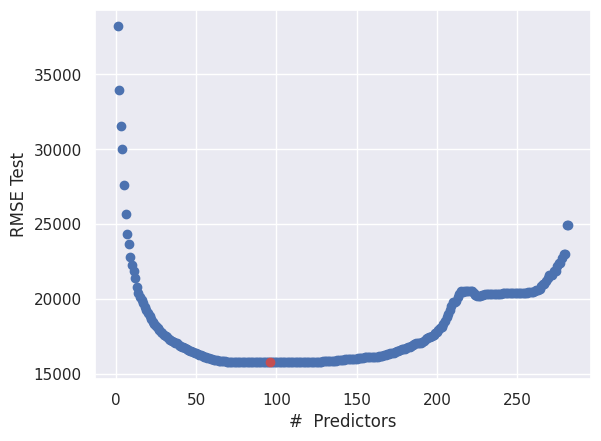

In [ ]:
plt.plot(models['p'],models['RMSE'],'ob')
plt.xlabel('#  Predictors')
plt.ylabel('RMSE Test')
plt.plot(models['p'][models['RMSE'].idxmin()], models['RMSE'].min(), 'or')

In [ ]:
models[80:100]

,p,RMSE,features,model
81,81,15760.151370,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...
82,82,15758.314870,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...
83,83,15757.177510,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...
84,84,15756.417043,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...
85,85,15755.777034,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...
86,86,15755.251865,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...
87,87,15755.050474,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...
88,88,15755.044341,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...
89,89,15755.031171,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...
90,90,15755.031171,"[OverallQual, GarageArea, MSZoning_RM, ExterQu...",<statsmodels.regression.linear_model.Regressio...


##### Use the entire training Set (no test set)

In [ ]:
models.columns

Index(['p', 'RMSE', 'features', 'model'], dtype='object')

In [ ]:
models_no_test = pd.DataFrame(columns=['RMSE', 'model'])

predictors = []

for i in range(1,292):
    models_no_test.loc[i] = forward(predictors, X, y, X, y)
    predictors = models_no_test.loc[i]['model'].model.exog_names

Streaming output truncated to the last 5000 lines.
 Option # 20: ['OverallQual', 'GarageArea', 'GrLivArea', 'ExterQual_Gd', 'BsmtFinSF1', 'MSZoning_RM', 'BsmtQual_Ex', 'MSSubClass', 'BsmtExposure_Gd', 'Foundation_PConc', 'KitchenQual_Ex', 'Fireplaces', 'Neighborhood_NoRidge', 'OverallCond', 'Neighborhood_NridgHt', 'BsmtQual_Gd', 'SaleCondition_Partial', 'Exterior1st_BrkFace', 'Condition1_Artery', 'YrSold', 'YearBuilt', 'Neighborhood_Crawfor', 'TotalBsmtSF', 'Functional_Min1', 'SaleCondition_Normal', 'Neighborhood_Somerst', 'LotArea', 'Neighborhood_StoneBr', 'ScreenPorch', 'WoodDeckSF', 'SaleType_Con', 'BldgType_1Fam', 'SaleType_CWD', 'HeatingQC_Ex', 'HouseStyle_2.5Unf', 'Condition1_RRAe', 'LotConfig_FR2', 'Neighborhood_BrkSide', 'Neighborhood_Blmngtn', 'Neighborhood_NPkVill', 'BsmtFullBath', 'ExterQual_TA', 'Exterior2nd_MetalSd', 'YearRemodAdd', '2ndFlrSF', 'LandSlope_Mod', 'GarageQual_Po', 'ExterCond_Gd', 'GarageType_2Types', 'HeatingQC_TA', 'Neighborhood_Edwards', 'Heating_OthW', 'Co

KeyError: 'RMSE'

In [ ]:
plt.plot(models_no_test['RMSE'],'ob')
plt.xlabel('#  Predictors')
plt.ylabel('RMSE Train')
plt.plot(models_no_test['RMSE'].astype(float).idxmin(), models_no_test['RMSE'].min(), 'or');

##### Plotting both the Test and Train RMSE on the same graph to enhance the difference visibility.

In [ ]:
# Plot Test RMSE
plt.plot(models['p'], models['RMSE'], 'o-', color='blue', label='Test RMSE')
plt.plot(models['p'][models['RMSE'].idxmin()], models['RMSE'].min(), 's', color='red', label='Min Test RMSE')

# Plot Train RMSE
plt.plot(models_no_test['RMSE'], 'o-', color='green', label='Train RMSE')
plt.plot([models_no_test['RMSE'].astype(float).idxmin()],
         models_no_test['RMSE'].min(), 'D', color='red', label='Min Train RMSE')

# Label underfitting (first point on Test RMSE)
plt.annotate('Underfitting',
             xy=(models['p'].iloc[0], models['RMSE'].iloc[0]),
             xytext=(models['p'].iloc[0]+0.5, models['RMSE'].iloc[0]+0.5),
             arrowprops=dict(facecolor='black', arrowstyle='->'))

# Label best (minimum Test RMSE)
best_idx = models['RMSE'].idxmin()
plt.annotate('Best',
             xy=(models['p'][best_idx], models['RMSE'].min()),
             xytext=(models['p'][best_idx]-1, models['RMSE'].min()+0.5),
             arrowprops=dict(facecolor='black', arrowstyle='->'))

# Label overfitting (last point on Test RMSE)
plt.annotate('Overfitting',
             xy=(models['p'].iloc[-1], models['RMSE'].iloc[-2]),
             xytext=(models['p'].iloc[-1]-2, models['RMSE'].iloc[-1]+0.5),
             arrowprops=dict(facecolor='black', arrowstyle='->'))

plt.xlabel('# Predictors')
plt.ylabel('RMSE')
plt.title('Train vs Test RMSE vs # Predictors')
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
print("Best 91 Variables from our training/test split:")
print(sorted(models.loc[91, 'model'].model.exog_names))

print("----")

print("Best 91 Variables using the entire model (no test set):")
print(sorted(models_no_test.loc[91, 'model'].model.exog_names))

#### After getting the best variables to use in the predictions i would be making a model for prediction.

In [ ]:
best_features = models_no_test.loc[91, 'model'].model.exog_names
X_best_train = X[best_features]
y_best = training_cum_onehot['SalePrice']

final_model = LinearRegression()
final_model.fit(X_best_train,y_best) # this fits the model

In [ ]:
# Predict on the test set
X_best_test = test_cum_onehot[best_features]
predictions = final_model.predict(X_best_test)

# convert the predictions to a LIST of POSITIVE INTEGERS (do not submit decimals!)
list_predictions = predictions.tolist()
rounded_list_predictions = [int(x) for x in list_predictions]
print(rounded_list_predictions)

In [ ]:
# copy paste the list into a function called "my_answer_list()"
# then save this function as "calculator.py" and submit it to Gradescope
# your answers should be integers

def my_answer_list():
  return [219997, 128080, 116288, 135032, 125011, 253012, 64183, 185700, 155210, 161263, 140838, 301821, 271981, 180029, 148426, 425129, 125186, 166172, 216376, 60665, 113460, 189482, 155952, 185942, 124412, 115005, 189310, 206582, 178918, 120771, 120968, 151838, 335190, 237221, 159376, 169136, 106872, 145305, 220122, 212373, 158573, 155316, 202020, 118480, 129156, 107243, 125157, 223787, 275606, 184600, 269100, 149101, 122846, 203375, 169070, 173483, 109386, 192889, 137158, 121415, 92464, 88735, 154805, 115948, 213704, 239913, 187443, 217707, 279630, 80474, 211654, 248688, 90667, 233818, 190095, 204599, 118938, 184050, 126124, 152201, 137824, 185664, 237951, 238102, 129115, 230817, 255877, 149687, 270282, 164337, 177829, 183915, 326306, 146530, 123794, 86895, 122903, 208947, 148275, 105885, 201685, 113842, 295698, 160324, 112486, 114594, 200659, 145258, 253829, 359514, 218450, 201855, 65913, 147528, 103443, 146220, 145454, 209997, 254279, 310898, 253232, 202995, 310321, 148145, 105737, 210622, 181990, 113166, 186117, 125000, 208544, 179923, 241690, 162264, 122887, 198909, 206999, 144242, 360859, 120241, 81653, 179904, 151947, 373523, 163963, 120345, 211294, 158096, 280495, 144663, 221358, 156903, 147113, 161948, 135073, 389398, 235989, 149127, 406093, 116219, 242867, 206826, 127781, 171974, 127217, 135445, 276681, 109156, 105573, 210560, 120497, 280262, 148121, 139572, 128817, 139085, 234875, 116137, 257264, 88321, 396108, 144791, 141799, 107196, 219931, 128963, 123675, 157234, 113125, 138086, 205973, 329684, 153349, 150473, 157740, 76906, 203139, 334540, 197847, 175895, 161904, 126802, 153897, 320508, 109337, 247391, 153076, 158097, 291638, 70614, 137742, 142312, 111182, 293637, 148616, 211165, 225681, 102049, 63575, 109504, 148469, 194036, 274845, 141896, 295329, 199148, 140065, 146739, 222424, 159122, 104840, 256729, 211614, 118720, 130812, 149272, 179229, 151758, 230133, 160336, 272324, 195506, 172841, 148382, 91081, 187872, 226754, 141280, 87300, 212208, 159463, 190301, 158770, 147064, 136022, 161289, 173108, 149184, 144720, 152811, 95878, 184671, 120672, 300372, 206490, 115178, 157161, 133431, 153200, 156618, 164812, 91471, 155460, 125635, 237051, 133539, 100231, 170735, 196542, 164652, 172679, 204869, 215349, 291921, 89456, 198664, 251333, 146529, 136784, 197863, 129842, 138465, 165712, 84374, 98593, 194609, 234072, 212845, 185671, 161933, 151113, 227265, 107982, 168379, 153673, 154982, 285391, 128514, 292081, 230978, 79157, 260116, 324430, 142360, 137810, 194530, 169567, 246412, 165486, 217525, 97338, 197851, 107209, 117044, 123794, 178296, 169720, 193821, 167704, 172326, 164568, 134980, 118808, 38462, 105148, 325880, 132086, 190369, 135991, 230705, 71617, 156030, 205331, 145067, 155780, 223318, 348898, 150781, 142205, 226437, 174779, 224077, 124027, 130801, 153050, 189590, 169972, 179194, 162201, 229829, 117892, 88929, 198127, 265093, 213068, 284403, 166301, 192357, 155629, 142297, 191210, 134415, 155880, 173249, 121128, 207779, 254498, 213024, 97139, 122398, 272390, 161226, 223429, 179873, 174629, 73333, 133510, 128303, 126546, 155613, 311065, 342686, 207959, 155517, 187636, 220321, 110505, 199259, 266547, 92994, 72353, 237169, 107142, 127866, 127152, 232554, 190506, 253235, 261601, 205634, 371889, 188240, 160731, 168604, 191235, 128015, 231929, 176885, 243697, 92757, 63855, 105190, 352671, 123131, 144972, 130922, 187059, 204856, 272515, 119324, 93026, 311272, 197869, 128951, 187974, 185071, 359914, 343783, 100824, 103259, 260492, 173855, 209042, 260428, 137144, 153115]


# The RMSE for this particular example is: 69577

# Note: If your RMSE is "9999999" that means you submitted a list that is the wrong length

